## 모델과 파라미터 찾기

In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

df = pd.read_csv("diabetes_feature.csv")
df.shape

(768, 16)

In [6]:
X = df.drop(['Outcome', 'Insulin', 'Insulin_nan'], axis=1)
y = df['Outcome']

In [7]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

In [8]:
X_train.shape, y_train.shape, X_test.shape, y_test.shape

((614, 13), (614,), (154, 13), (154,))

### 의사결정나무로 모델링

In [15]:
from sklearn.tree import DecisionTreeClassifier

model = DecisionTreeClassifier(max_depth=11, random_state=42)
model

DecisionTreeClassifier(max_depth=11, random_state=42)

In [16]:
model.fit(X_train, y_train)


/opt/homebrew/anaconda3/envs/lecture/lib/python3.9/site-packages/sklearn/utils/validation.py:767: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if not hasattr(array, "sparse") and array.dtypes.apply(is_sparse).any():
/opt/homebrew/anaconda3/envs/lecture/lib/python3.9/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/anaconda3/envs/lecture/lib/python3.9/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/anaconda3/envs/lecture/lib/python3.9/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and wil

DecisionTreeClassifier(max_depth=11, random_state=42)

In [17]:
y_predict = model.predict(X_test)
abs(y_predict - y_test).sum()

/opt/homebrew/anaconda3/envs/lecture/lib/python3.9/site-packages/sklearn/utils/validation.py:767: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if not hasattr(array, "sparse") and array.dtypes.apply(is_sparse).any():
/opt/homebrew/anaconda3/envs/lecture/lib/python3.9/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/anaconda3/envs/lecture/lib/python3.9/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):


27

In [18]:
from sklearn.metrics import accuracy_score
 
accuracy_score(y_test, y_predict) * 100


/opt/homebrew/anaconda3/envs/lecture/lib/python3.9/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/anaconda3/envs/lecture/lib/python3.9/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/anaconda3/envs/lecture/lib/python3.9/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/anaconda3/envs/lecture/lib/python3.9/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstan

82.46753246753246

#### 최적 파라미터 찾기

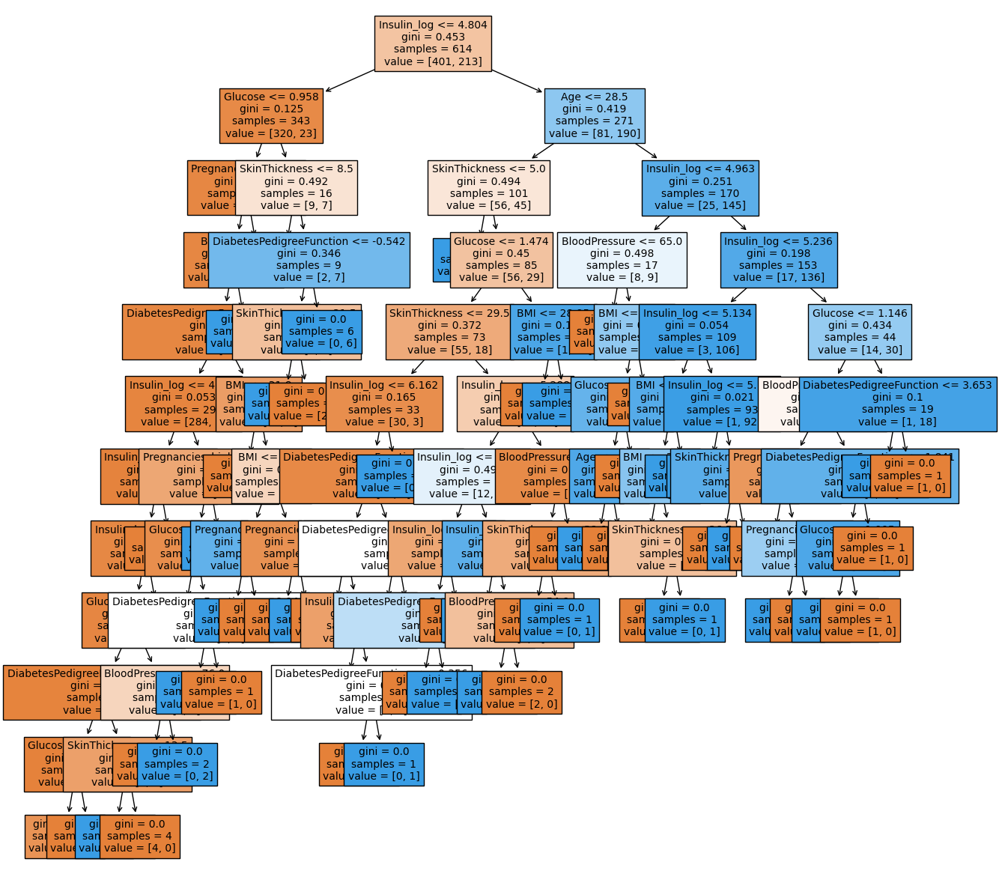

In [19]:
feature_names = X_train.columns.tolist()

from sklearn.tree import plot_tree

plt.figure(figsize=(15, 15))
tree = plot_tree(model, feature_names=feature_names, fontsize=10, filled=True)

In [22]:
for max_depth in range(3, 12):
    model = DecisionTreeClassifier(max_depth=max_depth, random_state=42)
    y_predict = model.fit(X_train, y_train).predict(X_test)
    score = accuracy_score(y_test, y_predict) * 100
    print(max_depth, score)

3 85.06493506493507
4 87.66233766233766
5 86.36363636363636
6 82.46753246753246
7 81.81818181818183
8 81.81818181818183
9 79.87012987012987
10 83.76623376623377
11 82.46753246753246


/opt/homebrew/anaconda3/envs/lecture/lib/python3.9/site-packages/sklearn/utils/validation.py:767: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if not hasattr(array, "sparse") and array.dtypes.apply(is_sparse).any():
/opt/homebrew/anaconda3/envs/lecture/lib/python3.9/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/anaconda3/envs/lecture/lib/python3.9/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/anaconda3/envs/lecture/lib/python3.9/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and wil

#### GridSearchCV

In [23]:
from sklearn.model_selection import GridSearchCV

model = DecisionTreeClassifier(random_state=42)
param_grid = {"max_depth": range(3, 12),
"max_features": [0.3, 0.5, 0.7, 0.9, 1]}
clf = GridSearchCV(model, param_grid=param_grid, n_jobs=-1, cv=5, verbose=2)
clf.fit(X_train, y_train)

Fitting 5 folds for each of 45 candidates, totalling 225 fits


/opt/homebrew/anaconda3/envs/lecture/lib/python3.9/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/anaconda3/envs/lecture/lib/python3.9/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/anaconda3/envs/lecture/lib/python3.9/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/anaconda3/envs/lecture/lib/python3.9/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstan

[CV] END ......................max_depth=3, max_features=0.3; total time=   0.0s
[CV] END ......................max_depth=3, max_features=0.5; total time=   0.0s
[CV] END ......................max_depth=3, max_features=0.3; total time=   0.0s
[CV] END ......................max_depth=3, max_features=0.3; total time=   0.0s
[CV] END ......................max_depth=3, max_features=0.3; total time=   0.0s
[CV] END ......................max_depth=3, max_features=0.5; total time=   0.0s
[CV] END ......................max_depth=3, max_features=0.5; total time=   0.0s
[CV] END ......................max_depth=3, max_features=0.3; total time=   0.0s
[CV] END ......................max_depth=3, max_features=0.5; total time=   0.0s
[CV] END ......................max_depth=3, max_features=0.5; total time=   0.0s
[CV] END ......................max_depth=3, max_features=0.7; total time=   0.0s
[CV] END ......................max_depth=3, max_features=0.7; total time=   0.0s
[CV] END ...................

/opt/homebrew/anaconda3/envs/lecture/lib/python3.9/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/anaconda3/envs/lecture/lib/python3.9/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/anaconda3/envs/lecture/lib/python3.9/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/anaconda3/envs/lecture/lib/python3.9/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstan

GridSearchCV(cv=5, estimator=DecisionTreeClassifier(random_state=42), n_jobs=-1,
             param_grid={'max_depth': range(3, 12),
                         'max_features': [0.3, 0.5, 0.7, 0.9, 1]},
             verbose=2)

In [26]:
print(clf.best_params_)
print(clf.best_estimator_)
print(clf.best_score_)

{'max_depth': 6, 'max_features': 0.9}
DecisionTreeClassifier(max_depth=6, max_features=0.9, random_state=42)
0.868092762894842


In [28]:
pd.DataFrame(clf.cv_results_).sort_values(by="rank_test_score").head()

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_max_depth,param_max_features,params,split0_test_score,split1_test_score,split2_test_score,split3_test_score,split4_test_score,mean_test_score,std_test_score,rank_test_score
18,0.002376,0.000900,0.008908,0.016044,6,0.9,"{'max_depth': 6, 'max_features': 0.9}",0.878049,0.886179,0.813008,0.886179,0.877049,0.868093,0.027813,1
13,0.002772,0.000628,0.001454,0.000350,5,0.9,"{'max_depth': 5, 'max_features': 0.9}",0.845528,0.878049,0.837398,0.878049,0.877049,0.863215,0.017949,2
21,0.006517,0.009642,0.001062,0.000258,7,0.5,"{'max_depth': 7, 'max_features': 0.5}",0.853659,0.910569,0.813008,0.829268,0.877049,0.856711,0.034603,3
31,0.005669,0.006331,0.003001,0.004099,9,0.5,"{'max_depth': 9, 'max_features': 0.5}",0.869919,0.894309,0.821138,0.845528,0.844262,0.855031,0.024978,4
43,0.003585,0.001714,0.001089,0.000111,11,0.9,"{'max_depth': 11, 'max_features': 0.9}",0.837398,0.910569,0.821138,0.869919,0.827869,0.853379,0.033136,5


In [31]:
clf.predict(X_test), clf.score(X_test, y_test)

/opt/homebrew/anaconda3/envs/lecture/lib/python3.9/site-packages/sklearn/utils/validation.py:767: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if not hasattr(array, "sparse") and array.dtypes.apply(is_sparse).any():
/opt/homebrew/anaconda3/envs/lecture/lib/python3.9/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/anaconda3/envs/lecture/lib/python3.9/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/anaconda3/envs/lecture/lib/python3.9/site-packages/sklearn/utils/validation.py:767: FutureWarning: is_sparse is deprecated and wil

(array([0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0,
        0, 0, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 0, 0, 1,
        0, 0, 0, 0, 0, 1, 0, 1, 1, 1, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0, 0, 0,
        0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0,
        0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 1, 1, 1, 0, 0, 1, 0, 1,
        0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0,
        0, 1, 1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0]),
 0.8506493506493507)

#### Random Search

In [36]:
max_depth = np.random.randint(3, 20, 10)
max_features = np.random.uniform(0.7, 1.0, 100)
 
param_distributions = {"max_depth" :max_depth,
           "max_features": max_features,
           "min_samples_split" : list(range(2, 7))
           }
param_distributions

{'max_depth': array([ 4, 13, 11, 14,  9, 18, 10, 10,  3,  5]),
 'max_features': array([0.955024  , 0.89177662, 0.884008  , 0.88275946, 0.9672828 ,
        0.73192157, 0.77546812, 0.78646074, 0.70559788, 0.83985342,
        0.74089768, 0.99009176, 0.820648  , 0.99435168, 0.99768036,
        0.96845281, 0.76187112, 0.80172125, 0.94016378, 0.80850901,
        0.85821306, 0.70858003, 0.88941728, 0.85575447, 0.72733068,
        0.7484536 , 0.83090984, 0.98201024, 0.9886508 , 0.74451345,
        0.78442462, 0.79800331, 0.86645372, 0.86403858, 0.95293255,
        0.9207184 , 0.85917302, 0.7695668 , 0.8697022 , 0.94122915,
        0.7658545 , 0.80304195, 0.72253173, 0.77395505, 0.94555849,
        0.84508029, 0.71483312, 0.80663862, 0.7497177 , 0.86267401,
        0.93851922, 0.98241091, 0.83554135, 0.96933089, 0.84104096,
        0.70122659, 0.79835725, 0.85553521, 0.70779453, 0.70058893,
        0.86379114, 0.92293623, 0.84018569, 0.87364041, 0.99136364,
        0.99229353, 0.89242599, 0.882

In [37]:
from sklearn.model_selection import RandomizedSearchCV

clf = RandomizedSearchCV(model,
    param_distributions,
    n_iter=1000,
    scoring="accuracy",
    n_jobs=-1,
    cv=5,
    random_state=42
    )

clf.fit(X_train, y_train)

/opt/homebrew/anaconda3/envs/lecture/lib/python3.9/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/anaconda3/envs/lecture/lib/python3.9/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/anaconda3/envs/lecture/lib/python3.9/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/anaconda3/envs/lecture/lib/python3.9/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstan

RandomizedSearchCV(cv=5, estimator=DecisionTreeClassifier(random_state=42),
                   n_iter=1000, n_jobs=-1,
                   param_distributions={'max_depth': array([ 4, 13, 11, 14,  9, 18, 10, 10,  3,  5]),
                                        'max_features': array([0.955024  , 0.89177662, 0.884008  , 0.88275946, 0.9672828 ,
       0.73192157, 0.77546812, 0.78646074, 0.70559788, 0.83985342,
       0.74089768, 0.99009176, 0.820648  , 0.99435168, 0.99768036,
       0.9684...
       0.9525629 , 0.9683161 , 0.87055486, 0.83199259, 0.86884106,
       0.78763509, 0.83872015, 0.74981016, 0.74668988, 0.96518146,
       0.8115498 , 0.7474606 , 0.86968851, 0.73881354, 0.99309143,
       0.78874469, 0.9204339 , 0.90168154, 0.98697494, 0.90885238,
       0.73304581, 0.76631207, 0.91873401, 0.7792867 , 0.84180141,
       0.92523967, 0.90438679, 0.71735536, 0.98070392, 0.97558752]),
                                        'min_samples_split': [2, 3, 4, 5, 6]},
                   random_state=42, scoring='accuracy')

In [38]:
print(clf.best_params_)
print(clf.best_score_)
print(clf.score(X_test, y_test))

{'min_samples_split': 2, 'max_features': 0.855754471573912, 'max_depth': 5}
0.8632147141143542
0.8571428571428571


/opt/homebrew/anaconda3/envs/lecture/lib/python3.9/site-packages/sklearn/utils/validation.py:767: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if not hasattr(array, "sparse") and array.dtypes.apply(is_sparse).any():
/opt/homebrew/anaconda3/envs/lecture/lib/python3.9/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/anaconda3/envs/lecture/lib/python3.9/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/anaconda3/envs/lecture/lib/python3.9/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and wil

In [39]:
pd.DataFrame(clf.cv_results_).sort_values(by="rank_test_score").head()

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_min_samples_split,param_max_features,param_max_depth,params,split0_test_score,split1_test_score,split2_test_score,split3_test_score,split4_test_score,mean_test_score,std_test_score,rank_test_score
193,0.001706,0.000043,0.001174,0.000722,3,0.864039,5,"{'min_samples_split': 3, 'max_features': 0.864...",0.845528,0.878049,0.837398,0.878049,0.877049,0.863215,0.017949,1
691,0.003018,0.001750,0.001696,0.001147,3,0.869702,5,"{'min_samples_split': 3, 'max_features': 0.869...",0.845528,0.878049,0.837398,0.878049,0.877049,0.863215,0.017949,1
982,0.001943,0.000034,0.000897,0.000059,3,0.859173,5,"{'min_samples_split': 3, 'max_features': 0.859...",0.845528,0.878049,0.837398,0.878049,0.877049,0.863215,0.017949,1
320,0.003641,0.002907,0.000919,0.000114,3,0.892426,5,"{'min_samples_split': 3, 'max_features': 0.892...",0.845528,0.878049,0.837398,0.878049,0.877049,0.863215,0.017949,1
50,0.002808,0.001235,0.002383,0.001016,2,0.855754,5,"{'min_samples_split': 2, 'max_features': 0.855...",0.845528,0.878049,0.837398,0.878049,0.877049,0.863215,0.017949,1
